In [1]:
# %pip install matplotlib

In [2]:
# %pip install scipy

In [4]:
from diffusers import DiffusionPipeline, StableDiffusionXLPipeline, StableDiffusionXLImg2ImgPipeline
import torch
import matplotlib.pyplot as plt

In [5]:
def show_images_side_by_side(images, titles=None, rows=1):
    num_images = len(images)
    cols = num_images // rows + (num_images % rows > 0)
    plt.figure(figsize=(20,10)) # You can adjust the figure size as per your requirement

    for i, image in enumerate(images):
        plt.subplot(rows,cols,i+1) # "rows,cols,i+1" means: in a grid rows x cols, put this in the i+1 slot
        plt.imshow(image)
        if titles is not None:
            plt.title(titles[i])
        plt.axis('off')   # Turn off axis numbers and ticks

    plt.tight_layout()
    plt.show()

In [4]:
base = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True)
base.enable_model_cpu_offload()

Loading pipeline components...: 100%|██████████| 7/7 [00:02<00:00,  2.92it/s]


In [5]:
refiner = StableDiffusionXLImg2ImgPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0",
    text_encoder_2=base.text_encoder_2,
    vae=base.vae,
    torch_dtype=torch.float16,
    use_safetensors=True,
    variant="fp16",
)
refiner.enable_model_cpu_offload()

# refiner = StableDiffusionXLImg2ImgPipeline.from_pretrained(
#     "stabilityai/stable-diffusion-xl-refiner-1.0",
#     # text_encoder_2=base.text_encoder_2,
#     # vae=base.vae,
#     torch_dtype=torch.float16,
#     use_safetensors=True,
#     variant="fp16",
# )
# refiner.enable_model_cpu_offload()

Loading pipeline components...: 100%|██████████| 5/5 [00:00<00:00,  5.28it/s]


In [17]:
def create_sdxl_image(prompt, seed, use_refiner=True, n_steps= 50, **kwargs):

    high_noise_frac = 0.8

    if seed:
        generator = torch.Generator(device="cuda").manual_seed(seed)
    else:
        generator = None
    
    image = base(prompt= prompt, 
                num_inference_steps= n_steps,
                denoising_end= high_noise_frac if use_refiner else 1.0,
                output_type= "latent" if use_refiner else "pil",
                generator= generator,
                **kwargs).images[0]

    if use_refiner:
        image = refiner(prompt=prompt, 
                        num_inference_steps= n_steps,
                        denoising_start = high_noise_frac,
                        image=image[None, :], 
                        generator= generator).images[0]

    return image

In [30]:
def og_v_refined(prompt, seed):
    image = create_sdxl_image(prompt, seed, use_refiner=False)
    refined = create_sdxl_image(prompt, seed)
    scene = prompt.split(',')[0]+ '...'
    show_images_side_by_side(images= [image, refined],
                         titles= [f'{scene} (Base model)', 'Base model and refiner'])

100%|██████████| 10/10 [00:03<00:00,  2.57it/s]


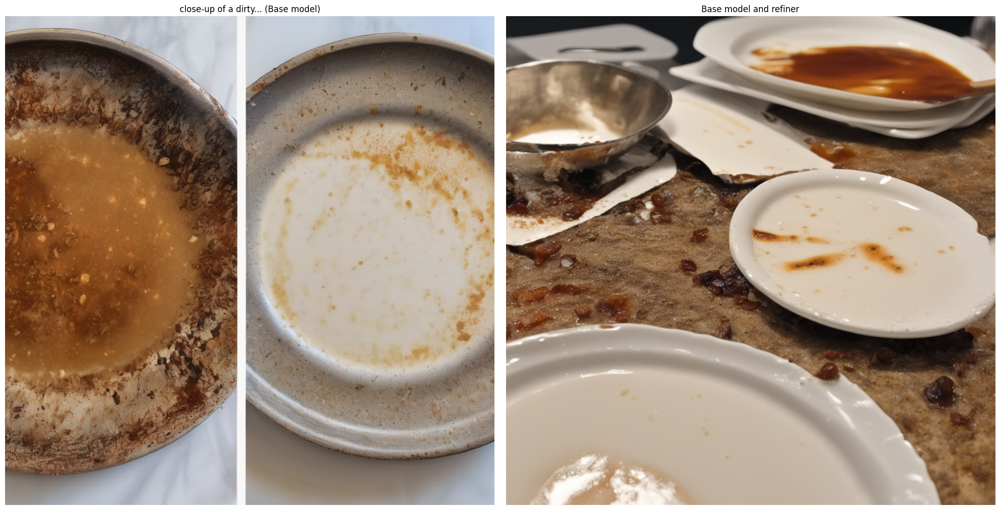

In [20]:
og_v_refined("close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is pristine and gleaming.")

100%|██████████| 10/10 [00:04<00:00,  2.48it/s]


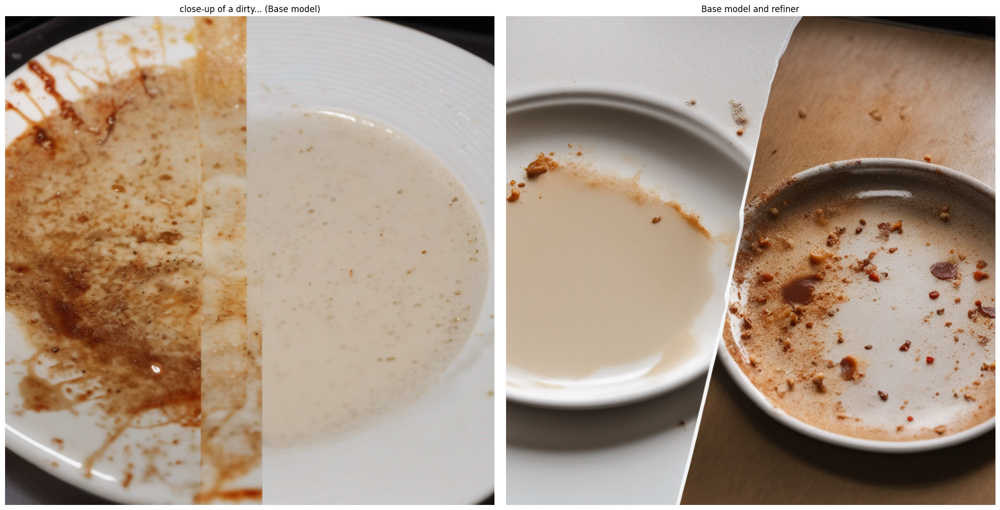

In [29]:
og_v_refined("close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is pristine and gleaming.", int(random.random()))

100%|██████████| 10/10 [00:03<00:00,  2.55it/s]


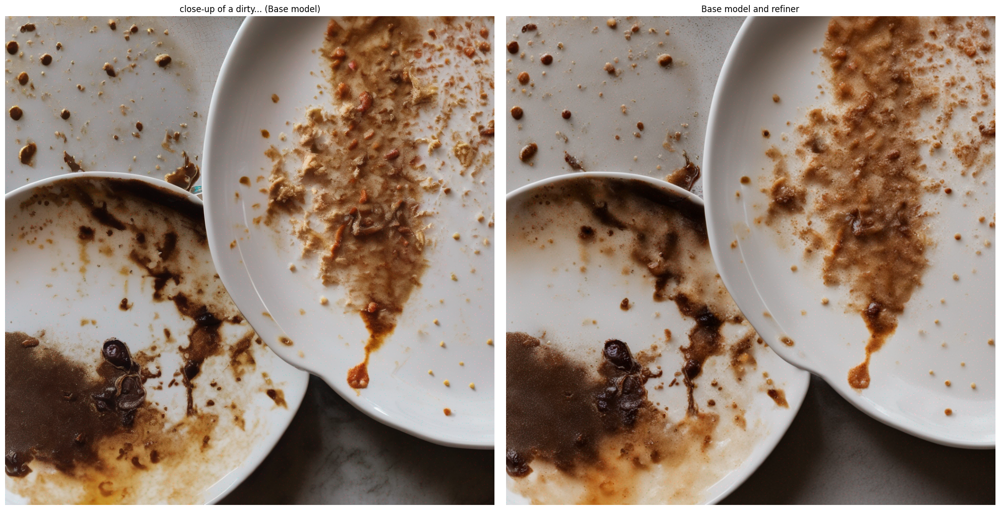

In [31]:
og_v_refined("close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is pristine and gleaming.", 57)

100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


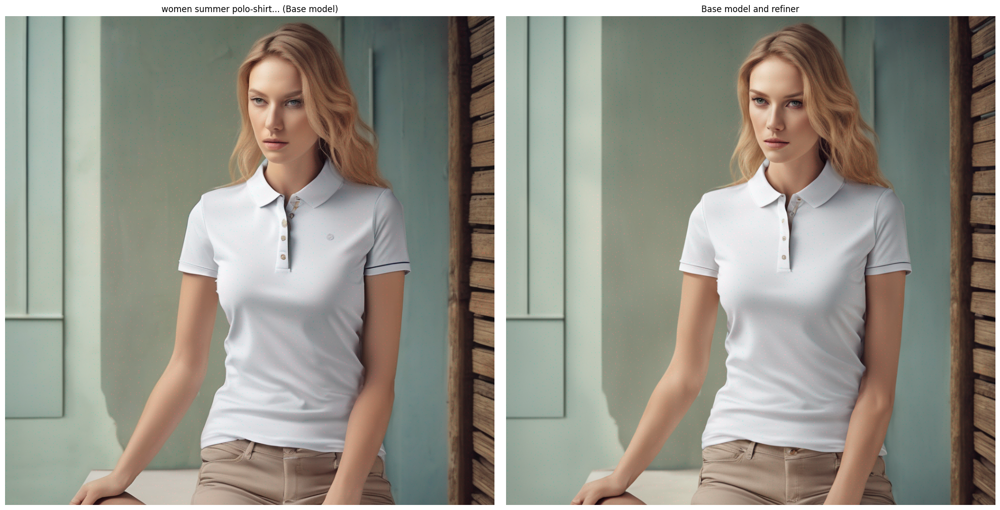

In [12]:
og_v_refined("women summer polo-shirt, detailed, photorealistic, professional fashion photo shooting, fashion magazine",3)

100%|██████████| 10/10 [00:04<00:00,  2.49it/s]


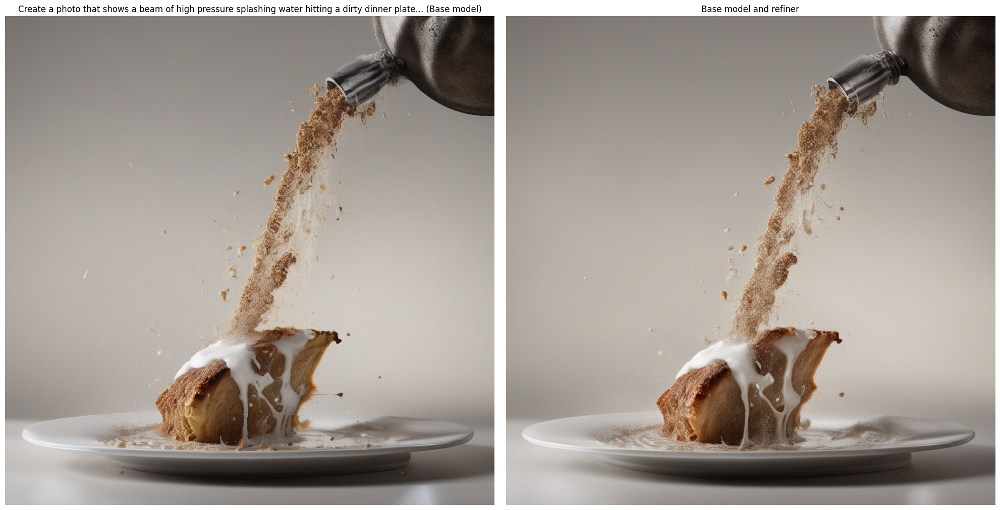

In [13]:
og_v_refined("Create a photo that shows a beam of high pressure splashing water hitting a dirty dinner plate, with the dirt being blasted off",87654)

100%|██████████| 10/10 [00:04<00:00,  2.48it/s]


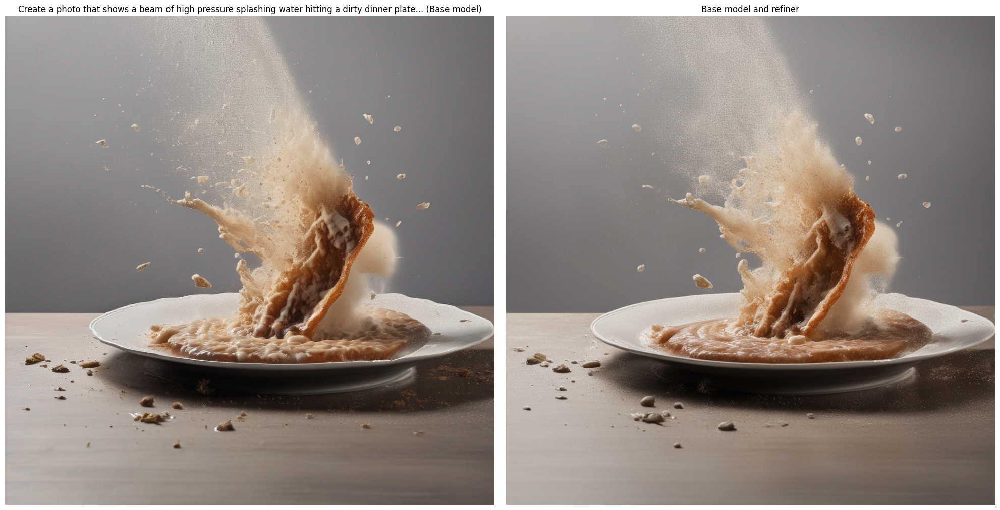

In [32]:
og_v_refined("Create a photo that shows a beam of high pressure splashing water hitting a dirty dinner plate, with the dirt being blasted off", 44)

  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 10/10 [00:03<00:00,  2.56it/s]


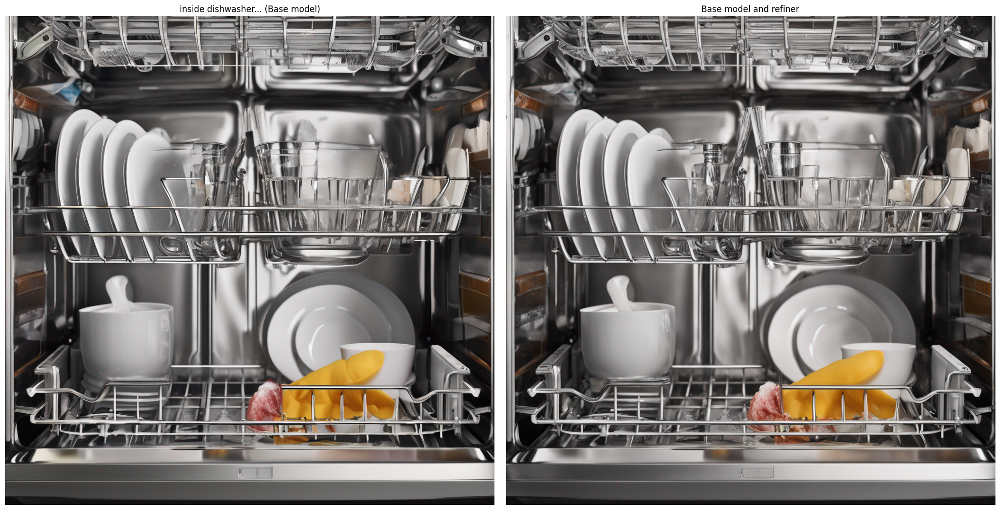

In [33]:
og_v_refined("inside dishwasher, zoomed in, dishes covered in food stains, water splashes from cleaning jets, photorealistic, detailed, professional product photo shooting, marketing", 23)

# Prompt based variations of existing images

In [3]:
import matplotlib.pyplot as plt
import torch
from diffusers import StableDiffusionXLImg2ImgPipeline
from diffusers.utils import load_image
import numpy as np

In [4]:
def show_images_side_by_side(images, titles=None, rows=1):
    num_images = len(images)
    cols = num_images // rows + (num_images % rows > 0)
    plt.figure(figsize=(20,10)) # You can adjust the figure size as per your requirement

    for i, image in enumerate(images):
        plt.subplot(rows,cols,i+1) # "rows,cols,i+1" means: in a grid rows x cols, put this in the i+1 slot
        plt.imshow(image)
        if titles is not None:
            plt.title(titles[i])
        plt.axis('off')   # Turn off axis numbers and ticks

    plt.tight_layout()
    plt.show()

In [6]:
# seed = 12345
# # seed = None
import random
seed = int(random.choice(range(0,10000000)))

if seed:
    generator = torch.Generator(device="cuda").manual_seed(seed)
else:
    generator = None

refiner = StableDiffusionXLImg2ImgPipeline.from_pretrained("stabilityai/stable-diffusion-xl-refiner-1.0", 
                                                           torch_dtype=torch.float16, 
                                                           use_safetensors=True, 
                                                           variant="fp16")
refiner.enable_model_cpu_offload()

Loading pipeline components...:   0%|                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            | 0/5 [00:00<?, ?it/s]

Loading pipeline components...: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:05<00:00,  1.18s/it]


In [7]:
def refine(init_image, prompt, strengths):
    refined_images = []

    for strength in strengths:
        
        refined_image = refiner(prompt=prompt,
                                num_inference_steps= 50,
                                strength= strength,
                                image= init_image, 
                                generator=generator).images[0]

        refined_images.append(refined_image)

    refined_strengths = [f'Strength: {strength:.2f}' for strength in strengths]
    show_images_side_by_side(images= [init_image, *refined_images],
                            titles= ['Original', *refined_strengths])

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:11<00:00,  2.94it/s]


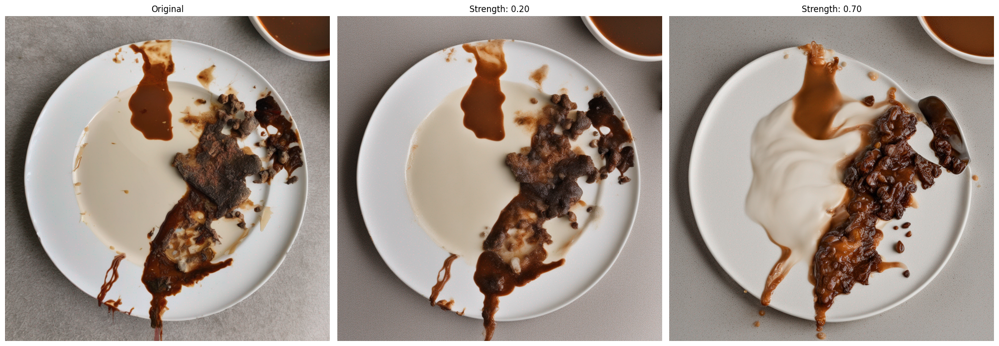

In [8]:
init_image = load_image("init_img.png").convert("RGB")
prompt = "single stream of water hitting the plate"
strengths = np.arange(0.2, 1, 0.5)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:05<00:00,  4.09it/s]


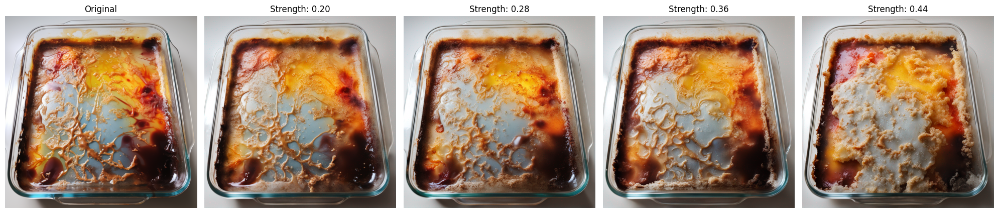

In [5]:
init_image = load_image("./leftover_food_stain.png").convert("RGB")
prompt = "leftover food stain on glass pyrex before cleaning and after cooking"
strengths = np.arange(0.2, 1, 0.5)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 46/46 [00:10<00:00,  4.39it/s]


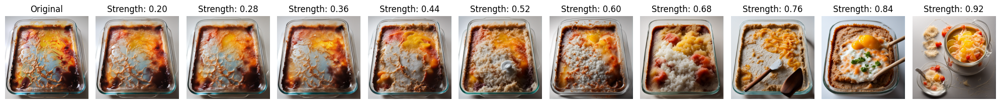

In [11]:
init_image = load_image("./leftover_food_stain.png").convert("RGB")
prompt = "food stains lifting from glass pyrex as a result of cleaning"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


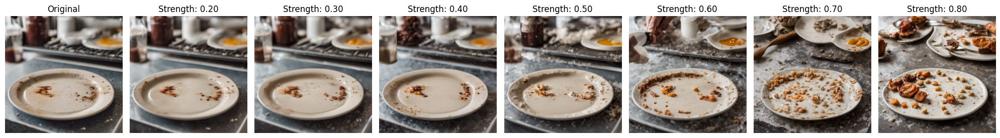

In [12]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is pristine and gleaming."
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


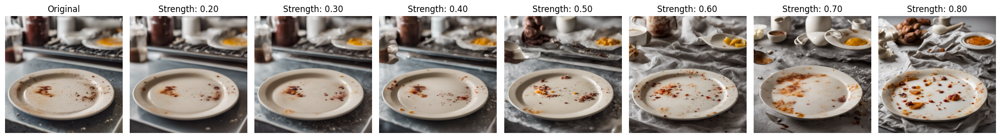

In [15]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "plate covered in food stains"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


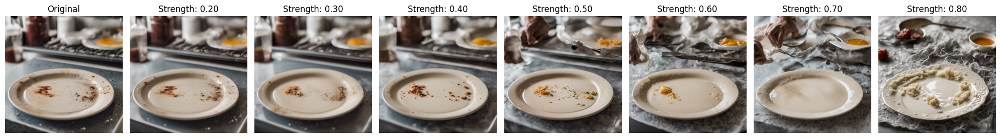

In [16]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "clean plate"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  2.98it/s]


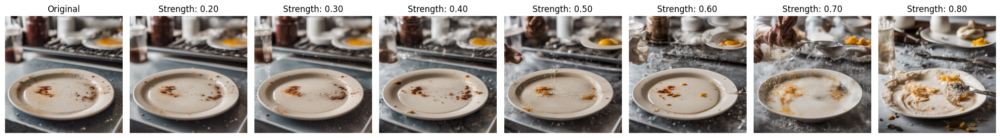

In [17]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "water hitting the plate, blasting off food stains"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


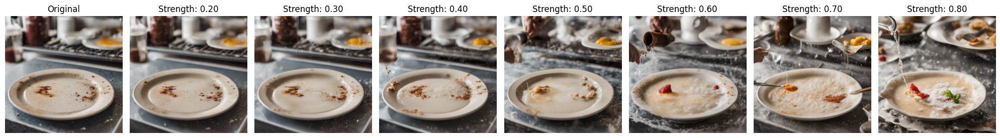

In [18]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "stream of water hitting the plate, blasting off food stains"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


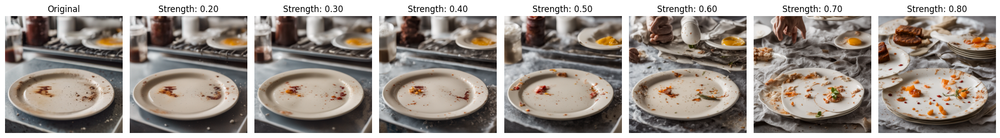

In [19]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "stack of plates with food stains"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


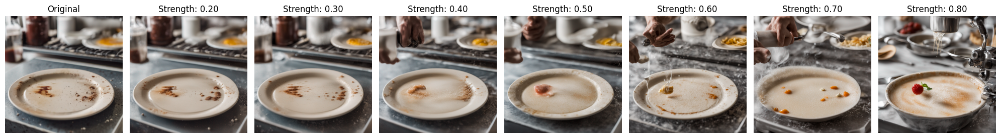

In [20]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "single beam of water hitting the plate, blasting off food stains"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.01it/s]


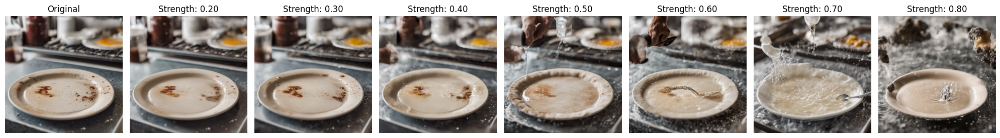

In [21]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "single, strong beam of water hitting the plate"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.01it/s]


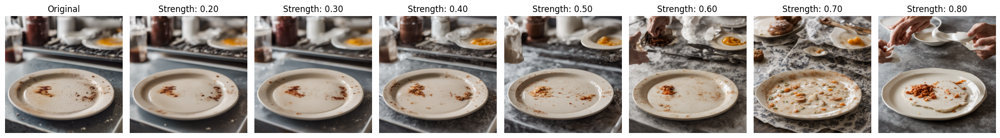

In [22]:
init_image = load_image("./plate.png").convert("RGB")
prompt = "before and after shot of plate, before is covered in food stains, after is clean"
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


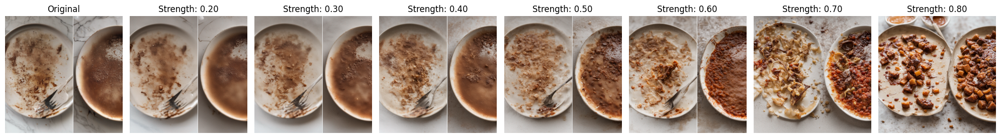

In [13]:
init_image = load_image("./plate1.png").convert("RGB")
prompt = "close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is pristine and gleaming."
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [00:13<00:00,  3.00it/s]


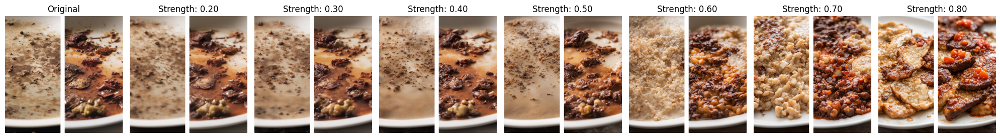

In [14]:
init_image = load_image("./plate2.png").convert("RGB")
prompt = "close-up of a dirty, stained plate before and after it goes through the dishwasher. In the before shot, you see all of the dried and caked-on bits of food and sauce. In the after shot, the plate is pristine and gleaming."
strengths = np.arange(0.2, 0.9, 0.1)

refine(init_image,prompt,strengths)

### Woman example - aging

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:07<00:00,  2.90it/s]


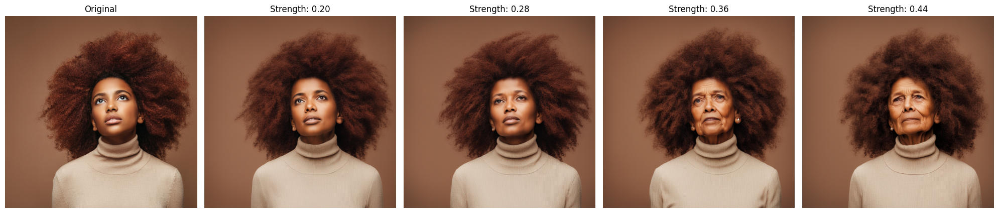

In [6]:
init_image = load_image("./no-smile-1024.png").convert("RGB")
prompt = "old woman"
strengths = np.arange(0.2, 0.5, 0.08)

refine(init_image,prompt,strengths)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 22/22 [00:07<00:00,  2.89it/s]


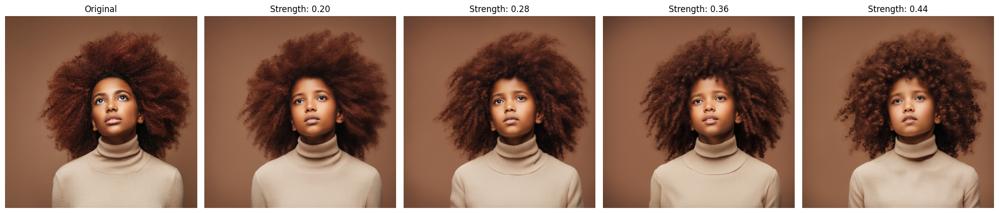

In [7]:
init_image = load_image("./no-smile-1024.png").convert("RGB")
prompt = "young girl"
strengths = np.arange(0.2, 0.5, 0.08)

refine(init_image,prompt,strengths)